
## Premise

Prior to building models, exploratory data analysis is undertaken to 
understand the data better using descriptive statistics among others.
To do this the various the datasets are read and attempt is made to understand
the variables. First all modules needed for the analysis are imported 
followed by reading the datasets.txt

In [2]:
import pandas as pd
import numpy as np
import datetime
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from prophet import Prophet
from prophet.plot import plot_seasonality
from prophet.plot import add_changepoints_to_plot
from prophet.diagnostics import cross_validation
from prophet.diagnostics import performance_metrics
from prophet.plot import plot_cross_validation_metric
import numpy as np
import itertools
from prophet.serialize import model_to_json, model_from_json
import json
import tensorflow as tf
from sklearn import preprocessing
from sklearn import metrics
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import (Bidirectional, LSTM, Flatten,
                                     TimeDistributed, RepeatVector, 
                                     Conv1D, MaxPool1D)
from keras.layers import LSTM, Dense, Bidirectional, MaxPool1D, Dropout

2023-07-24 14:06:26.207595: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.



All the dataset are read as follows:


In [4]:
app_starts = pd.read_csv('churn_prediction/dataset/app starts.txt', sep = "\t")
app_starts_july = pd.read_csv('churn_prediction/dataset/app starts july.txt', sep = "\t")
brochure_views = pd.read_csv('churn_prediction/dataset/brochure views.txt', sep = "\t")
brochure_views_july = pd.read_csv('churn_prediction/dataset/brochure views july.txt', sep = "\t")
installs_df = pd.read_csv('churn_prediction/dataset/installs.txt', sep = "\t")


The first exploration done on the dataset is to identify the various features, their 
data types and presence of missing values. The data types of features determines the 
type visualization and preprocessing techniques to apply to prepare the data for 
machine learning. For example, onehot encoding for categorical features and scaling 
for numerical features among others.

In [6]:
## to reduce repetition of same analysis for all dataset a loop is used
df_list = [app_starts, app_starts_july, brochure_views, brochure_views_july, installs_df]

for df in df_list:
    df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 144104 entries, 0 to 144103
Data columns (total 2 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   dateCreated  144104 non-null  object
 1   userId       144104 non-null  object
dtypes: object(2)
memory usage: 2.2+ MB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39969 entries, 0 to 39968
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   dateCreated  39969 non-null  object
 1   userId       39969 non-null  object
dtypes: object(2)
memory usage: 624.6+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 279213 entries, 0 to 279212
Data columns (total 6 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               279213 non-null  int64  
 1   userId           279213 non-null  object 
 2   dateCreated      279213 non-null  object 
 3   page_turn_count  2

Among others, id and userId are features in the dataset that are more of identifiers for the 
data and will prove useful for joining the dataset. These features however are not 
likely to provide predictive signals for modeling hence not explore for that 
purpose. userId is a feature in all the dataset hence used for joining them.

Another observation is that the dataset has dateCreated and InstallDate features 
which suggests the dataset is likely to exhibit the properties of time series. 

The data type of dateCreated and InstallDate is however not datetime as will 
be expected hence data type conversion will be undertaken.


In [8]:
for df in df_list:
    if 'dateCreated' in df.columns:
        df['dateCreated'] = pd.to_datetime(df['dateCreated'])

In [9]:
installs_df['InstallDate'] = pd.to_datetime(installs_df['InstallDate'])

From enquiries made, page_turn_count variable is interpreted as churn and hence identifed
as the target variable for the task.

The brochure views dataset contains the page_turn_count variable hence identifed as important 
for the analysis. It is possible that the brochure views july is meant to 
be a test dataset but will be merged with the brochure views dataset 
for exploratory analysis. install dataset also has features that needs to 
be explored to model hence will also be merged with the other other datasets.

Thus, the dataset identified as likely to be relevant for the model building 
are brochure views, brochure views july, and installs.

app starts and app starts july only contain identifiers which will not 
be relevant for the modeling task hence not used.

In [11]:
brochure_all = brochure_views.merge(brochure_views_july, how='outer')

brochure_install_all = brochure_all.merge(installs_df, how='outer', on='userId')

A key consideration for analyzing categorical features is cardinality. Generally,
categorical features with high cardinality when preprocessed with techniques 
such as one hot encoding leads to expotential growth in dimensionality. Despite 
there are techniques such as recategorizing for treating high cardinal features, 
this task will employ eliminating very high cardinal features for modeling.
Among other reasons for this, is the fact very little known about these 
features to devise an appropriate strtegy for recategorization.

The function for checking the cardinality of variables is defined as follows:  


In [13]:
categorical_vars = ['brochure_id', 'productId', 'model', 'campaignId']

def get_number_of_unique_values(data: pd.DataFrame, variable: str):
    num_values = data[variable].nunique()
    print(f'{variable} has {num_values} unique values')
    
    

for cat_var in categorical_vars:
    get_number_of_unique_values(data=brochure_install_all, variable=cat_var)   

brochure_id has 22854 unique values
productId has 3 unique values
model has 1210 unique values
campaignId has 933 unique values


from the cardinality check, only productId is of a low cardinal with 
3 unique values. Hence, productId is the only categorical variable to explored further.

Data visualization
Visualization of page_turn_count as the target variable is undertaken as
follows:


In [16]:
plotly_fig = px.line(data_frame=brochure_install_all, 
                    x='dateCreated', 
                    y='page_turn_count'
                    )

In [17]:
plotly_fig.show()

The time series plot of page_turn_count indicates the time scale for 
the data to be of a very high temporal resolution in addition
to the fact that interval for the data collection is irregular.

Thus, the data needs to be preprocessed to a time scale of equal time interval 
to ensure consistent prediction. To achieve this, the data is resampled 
to hourly intervals. By this, the total page_turn_count for every hour 
is estimated as the target variable to be predicted.

This approach presents a challenge for handling productId feature. 
productId is not numeric but nominal hence it is not possible to 
aggregate it at hourly interval as done for page_turn_count. Moreover,
counting the total number of productId as a feature will not add any insight 
given that it will essentially produce the number of data points recorded 
in an hour interval. Thus, only numeric features can be further explored
for modeling, and for this, view_duration will be used.

First, the dataset is resampled as follows:


In [20]:
brochure_install_all_subset = (brochure_install_all[['dateCreated', 'view_duration', 
                                                    'page_turn_count'
                                              ]]
                                .dropna(subset=['dateCreated'])
                                )
 
brochure_install_hourly = (brochure_install_all_subset
                           .resample('60min', on='dateCreated')
                           .sum().reset_index()
                           )

The resulting hourly aggregation of page_turn_count and view_duration 
are visualized as follows:


In [22]:
px.line(data_frame=brochure_install_hourly, 
        x='dateCreated', 
        y='page_turn_count',
        template='plotly_dark'
        )

In [23]:
px.line(data_frame=brochure_install_hourly, 
        x='dateCreated', 
        y='view_duration',
        template='plotly_dark'
        )

Text(0.5, 0, 'date time (hourly)')

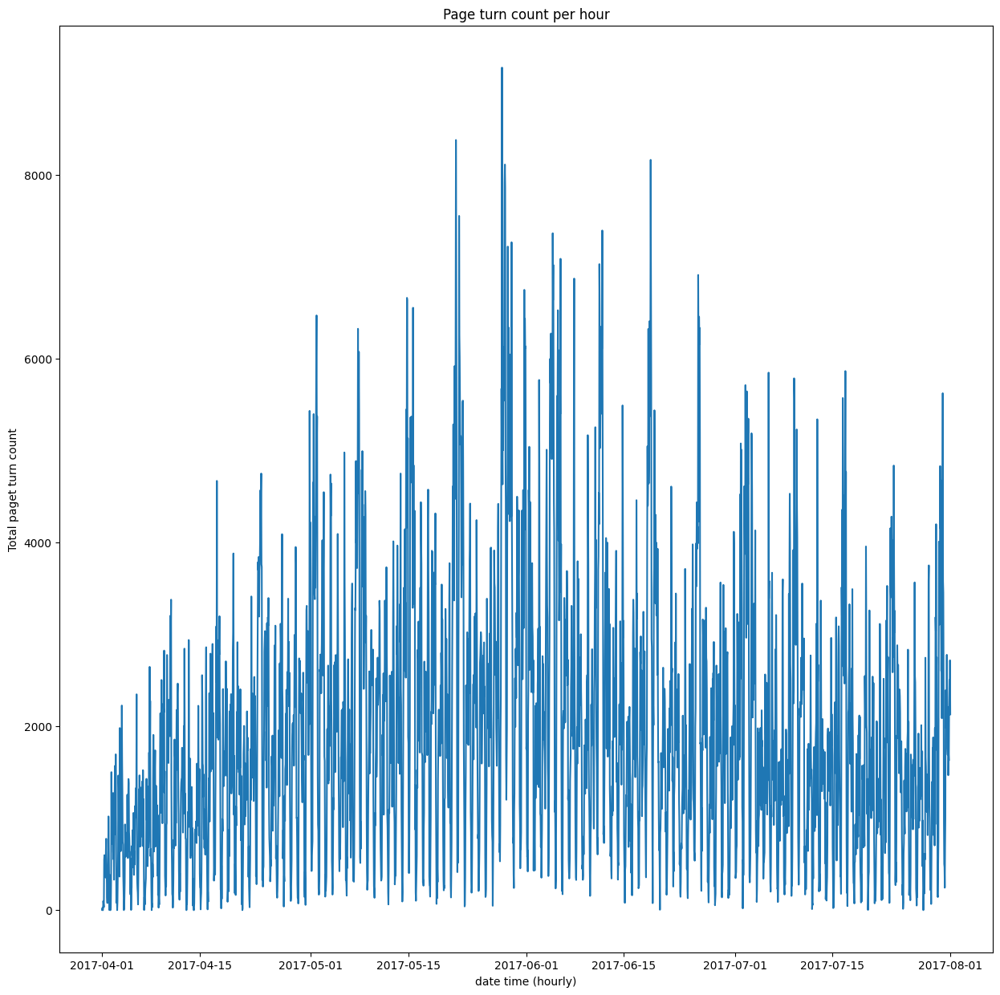

In [24]:
plt.figure(figsize=(15,15))
plt.plot(brochure_install_hourly['dateCreated'], 
        brochure_install_hourly['page_turn_count'],
        
        )
plt.title('Page turn count per hour')
plt.ylabel('Total paget turn count')
plt.xlabel('date time (hourly)')

In [25]:
def lineplot(data, y_var, x_var, title, ylabel, xlabel,
             width=15, height=15):
    plt.figure(figsize=(width,height))
    plt.plot(data[x_var], 
            data[y_var],
            
            )
    plt.title(title)
    plt.ylabel(ylabel)
    plt.xlabel(xlabel)
    return plt.show()

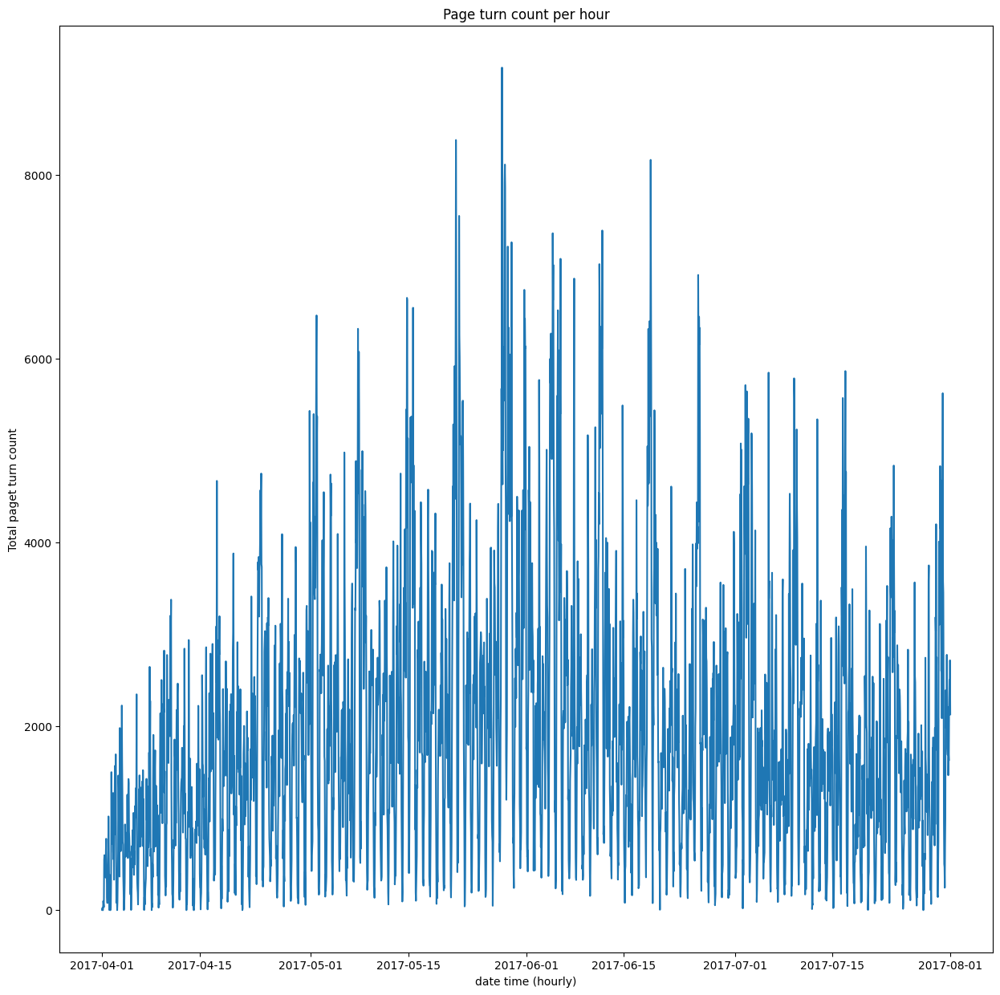

In [26]:
lineplot(data=brochure_install_hourly, 
            x_var='dateCreated', 
            y_var='page_turn_count',
            ylabel='Total paget turn count',
            xlabel='date time (hourly)',
            title='Page turn count per hour'
        )

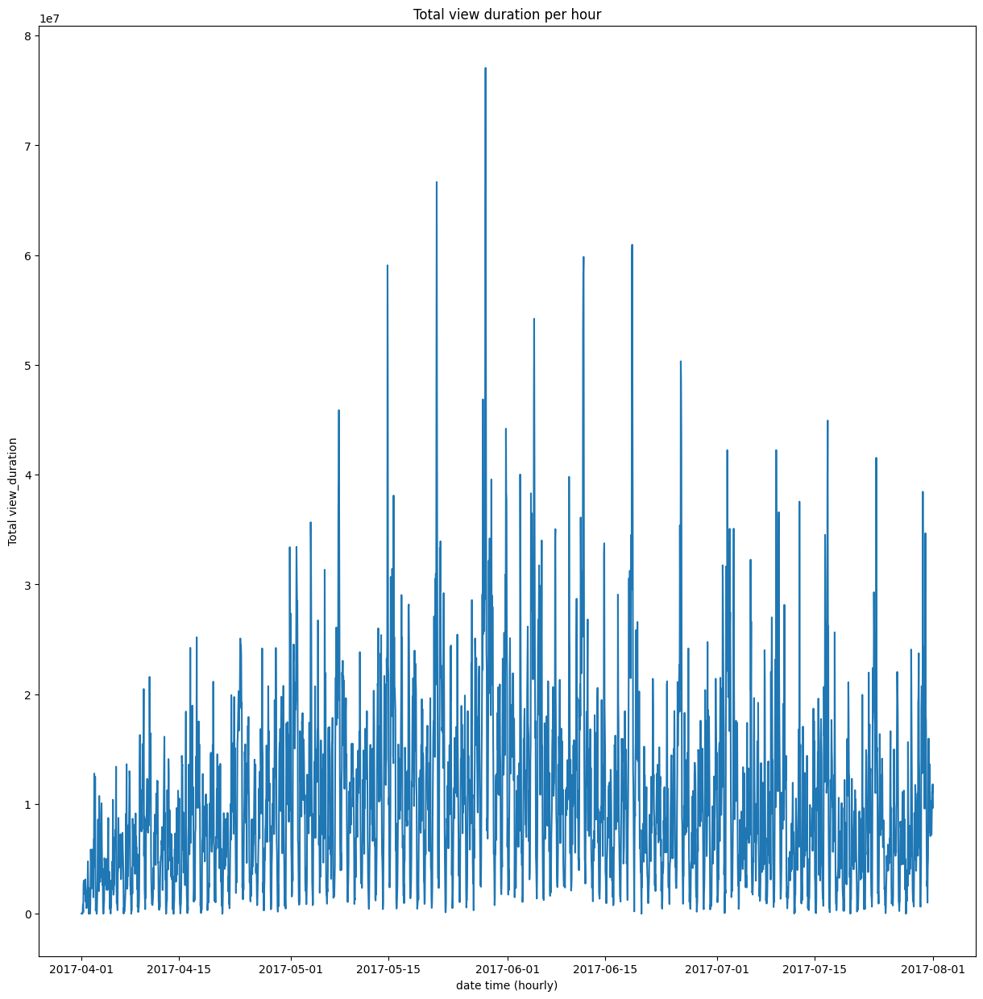

In [27]:
lineplot(data=brochure_install_hourly, 
            x_var='dateCreated', 
            y_var='view_duration',
            ylabel='Total view_duration',
            xlabel='date time (hourly)',
            title='Total view duration per hour'
        )


From the two plots, periods of high and low page turn count
correspond with those of high and low view duration respectively
hence view duration is likely to provide predictive signals 
for forecasting page turn count. Thus, view duration will be 
included as a predictor for the forecasting.

In order to understand the dataset better in terms of its 
time series properties, it is decompose into various components as 
trend, seasonality and residuals as follows:

In [29]:
brochure_install_hourly.set_index(keys='dateCreated', inplace=True)

In [30]:
brochure_install_hourly

,view_duration,page_turn_count
dateCreated,,
2017-04-01 00:00:00,29000.0,2.0
2017-04-01 01:00:00,42000.0,24.0
2017-04-01 02:00:00,0.0,0.0
2017-04-01 03:00:00,0.0,0.0
2017-04-01 04:00:00,212000.0,99.0
...,...,...
2017-07-31 19:00:00,9514084.0,2234.0
2017-07-31 20:00:00,11131581.0,2504.0
2017-07-31 21:00:00,10958040.0,2202.0


In [31]:
from statsmodels.tsa.seasonal import seasonal_decompose

In [32]:
def decompose_timeseries(data, variable_to_decompose,
                         plot_width = 15, plot_height = 15):
    decomposition = seasonal_decompose(data[variable_to_decompose])

    trend = decomposition.trend
    seasonal = decomposition.seasonal
    residual = decomposition.resid

    fig = plt.figure(figsize=(plot_width,plot_height))
    ax1 = fig.add_subplot(411)
    ax2 = fig.add_subplot(412)
    ax3 = fig.add_subplot(413)
    ax4 = fig.add_subplot(414)
    ax1.set_title(f'Original Time Series - {variable_to_decompose}')
    ax1.plot(data[variable_to_decompose])
    ax2.set_title('Trend')
    ax2.plot(trend)
    ax3.set_title('Seasonality')
    ax3.plot(seasonal)
    ax4.set_title('Residuals')
    ax4.plot(residual)
    plt.tight_layout()
    return plt.show()

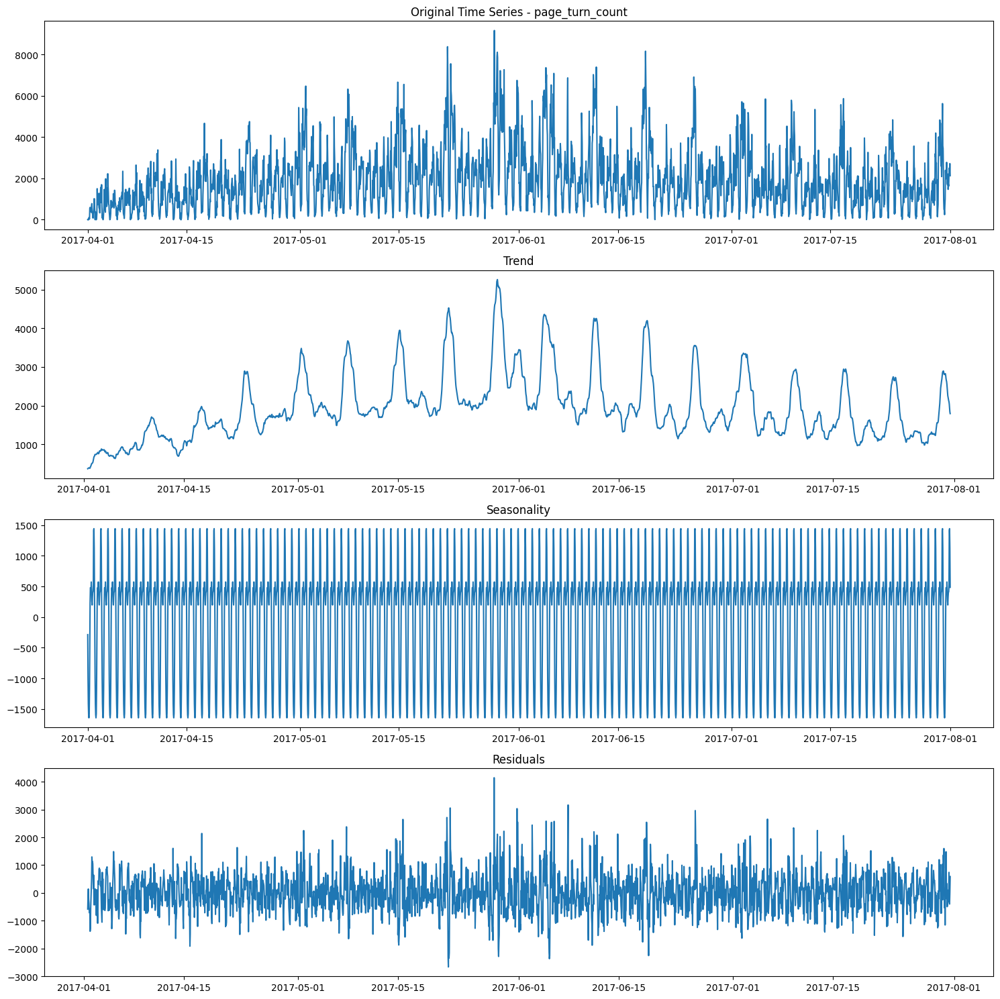

In [33]:
decompose_timeseries(data=brochure_install_hourly, variable_to_decompose='page_turn_count')

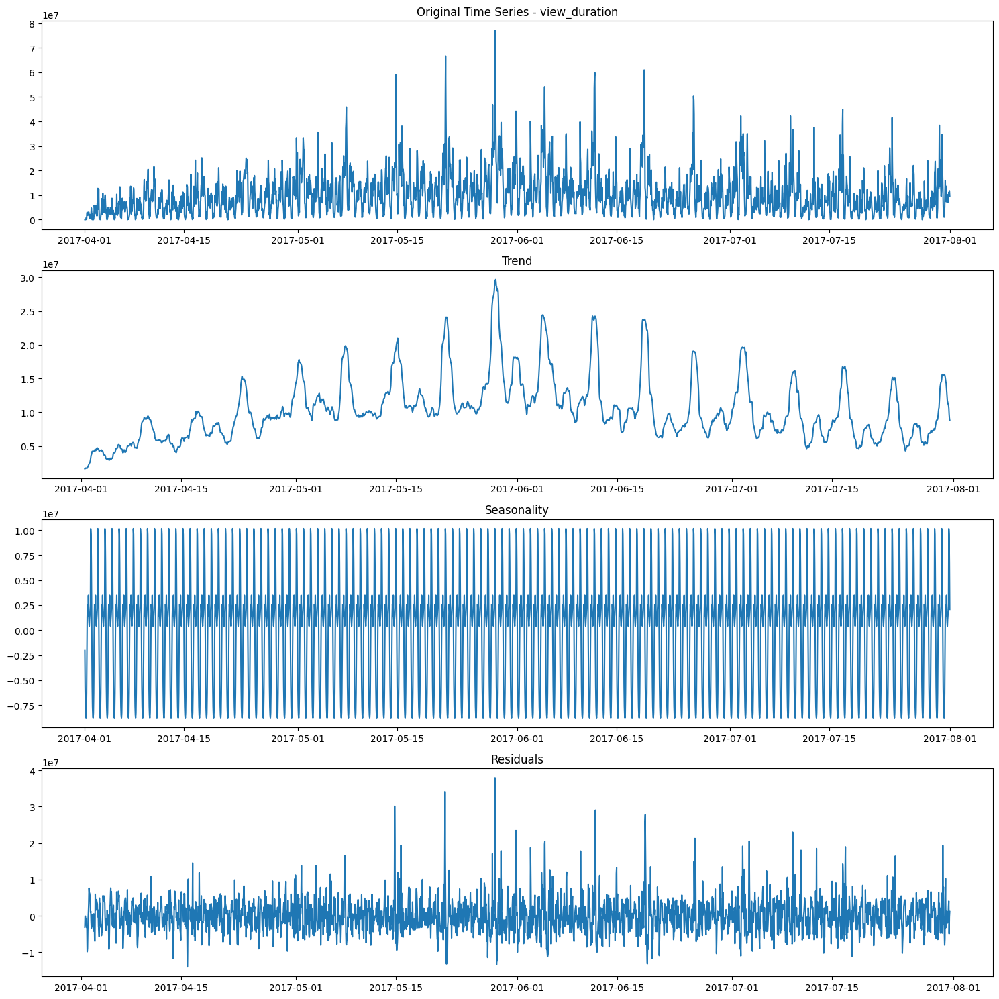

In [34]:
decompose_timeseries(data=brochure_install_hourly, 
                     variable_to_decompose='view_duration',
                     
                     )

from the decomposition, it is obvious view duration is experiencing the same 
trend and seasonality as page_turn_count hence can be used for prediction.
Moreover, the trend is multiplicative. This is an important insight gained for 
modeling purpose.

From the exploratory analysis, the the type of trend (multiplicative), 
relevant predictors (view duration) were determined. Also, the data was resampled
to hourly scale to ensure regular and consistent time interval for forecasting.

This provide the needed impetus for modeling. First, prophet model will be 
used. This is basically a linear regression model for time series forecasting.
Prophet uses probalilistic approach to modeling.

### Data preparation


The data is preprocessed for use in prophet model as follows:


In [37]:
brochure_install_prep = (brochure_install_hourly.reset_index()
                            .rename(columns={'dateCreated': 'ds', 'page_turn_count': 'y'})
                            [['ds','y','view_duration']]
                            
                        )

The model is then defined first with default parameters except changing 
the seasonality mode to multiplicative as identified for exploratory analysis.

Cross validation is used to evaluate the model.


In [40]:
# initialize model
model_cvm = Prophet(seasonality_mode='multiplicative')
# add predictor to the model
model_cvm.add_regressor('view_duration')
# fit the model on the preprocessed data
model_cvm.fit(brochure_install_prep)

14:11:48 - cmdstanpy - INFO - Chain [1] start processing
14:11:49 - cmdstanpy - INFO - Chain [1] done processing



for cross validation, a 30 days horizon is used. This is 
an hourly forecast of page turn count for 24 hours for 30 days.


In [42]:
df_cvm = cross_validation(model_cvm, 
                            horizon='30 days'
                         )

  0%|          | 0/1 [00:00<?, ?it/s]

14:11:58 - cmdstanpy - INFO - Chain [1] start processing
14:11:59 - cmdstanpy - INFO - Chain [1] done processing


In [43]:
df_cvm

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,2017-07-02 00:00:00,2630.532302,2057.073415,3200.777602,3260.0,2017-07-01 23:00:00
1,2017-07-02 01:00:00,836.607934,320.738937,1376.060630,1121.0,2017-07-01 23:00:00
2,2017-07-02 02:00:00,775.302019,244.967277,1286.638719,966.0,2017-07-01 23:00:00
3,2017-07-02 03:00:00,106.509195,-449.153007,621.095986,19.0,2017-07-01 23:00:00
4,2017-07-02 04:00:00,336.560323,-212.947184,871.660715,550.0,2017-07-01 23:00:00
...,...,...,...,...,...,...
715,2017-07-31 19:00:00,2279.004923,1656.395274,2888.187451,2234.0,2017-07-01 23:00:00
716,2017-07-31 20:00:00,2480.825851,1882.454745,3117.162361,2504.0,2017-07-01 23:00:00
717,2017-07-31 21:00:00,2500.143452,1879.857406,3126.709213,2202.0,2017-07-01 23:00:00
718,2017-07-31 22:00:00,2593.125031,2004.396348,3225.995158,2719.0,2017-07-01 23:00:00



Several evaluation emetrics were computed. The result for model with 
default parameters is a Root Mean Squared Error (RMSE) of 367.030746


In [45]:
df_cvm_perfmetric = performance_metrics(df_cvm, rolling_window=1)
df_cvm_perfmetric

,horizon,mse,rmse,mae,mdape,smape,coverage
0,30 days,134711.568146,367.030746,282.024596,0.164628,0.277082,0.865278


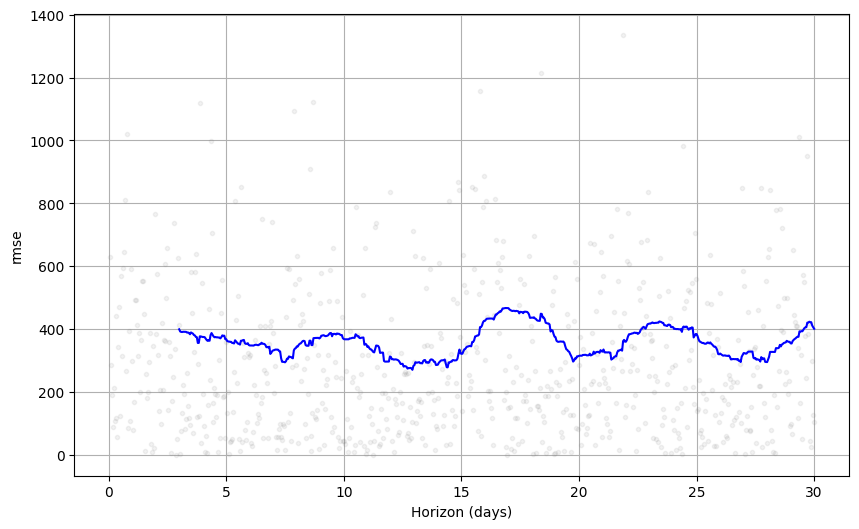

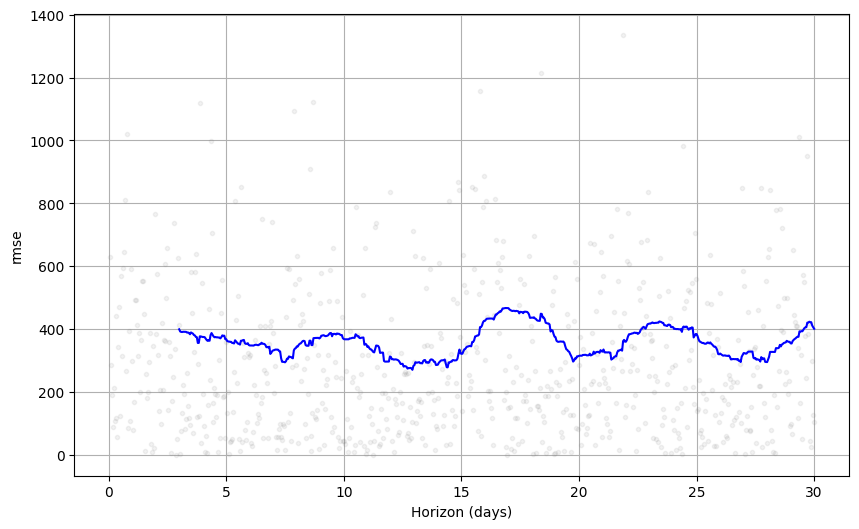

In [46]:
plot_cross_validation_metric(df_cvm, metric='rmse')


The graph above is visual representation of the cross validation
results of the model.

Next, the model is optimized through hyperparameter optimization 
using the grid search approach. 

Due to the computational expensiveness of undertaking grid search,
only a few parameters are specified. This is implemented as follows:


In [48]:
param_grid_m = {'changepoint_prior_scale': [0.5, 0.1, 0.01, 0.001],
              'seasonality_prior_scale': [10.0, 1, 0.1, 0.01],
              'seasonality_mode': ['additive', 'multiplicative']
              }

In [49]:
all_params_m = [dict(zip(param_grid_m.keys(), value))
              for value in itertools.product(*param_grid_m.values())]
rmse_values_m = []


After defining the hyperparameter search space, the model 
is trained using all permutations of hyperparameters specified 
and afterwards evaluated. This is implemented as follows:


In [51]:
for params in all_params_m:
    model = Prophet(**params)
    model.add_regressor(name='view_duration')
    model.fit(brochure_install_prep)
    df_cv = cross_validation(model, horizon='30 days')
    df_p = performance_metrics(df_cv, rolling_window=1)
    rmse_values_m.append(df_p['rmse'].values[0])

14:12:29 - cmdstanpy - INFO - Chain [1] start processing
14:12:31 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:12:31 - cmdstanpy - INFO - Chain [1] start processing
14:12:33 - cmdstanpy - INFO - Chain [1] done processing
14:12:34 - cmdstanpy - INFO - Chain [1] start processing
14:12:35 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:12:35 - cmdstanpy - INFO - Chain [1] start processing
14:12:36 - cmdstanpy - INFO - Chain [1] done processing
14:12:37 - cmdstanpy - INFO - Chain [1] start processing
14:12:40 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:12:41 - cmdstanpy - INFO - Chain [1] start processing
14:12:42 - cmdstanpy - INFO - Chain [1] done processing
14:12:43 - cmdstanpy - INFO - Chain [1] start processing
14:12:44 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:12:44 - cmdstanpy - INFO - Chain [1] start processing
14:12:45 - cmdstanpy - INFO - Chain [1] done processing
14:12:46 - cmdstanpy - INFO - Chain [1] start processing
14:12:48 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:12:49 - cmdstanpy - INFO - Chain [1] start processing
14:12:50 - cmdstanpy - INFO - Chain [1] done processing
14:12:51 - cmdstanpy - INFO - Chain [1] start processing
14:12:52 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:12:52 - cmdstanpy - INFO - Chain [1] start processing
14:12:54 - cmdstanpy - INFO - Chain [1] done processing
14:12:55 - cmdstanpy - INFO - Chain [1] start processing
14:12:57 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:12:57 - cmdstanpy - INFO - Chain [1] start processing
14:12:59 - cmdstanpy - INFO - Chain [1] done processing
14:12:59 - cmdstanpy - INFO - Chain [1] start processing
14:13:00 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:00 - cmdstanpy - INFO - Chain [1] start processing
14:13:01 - cmdstanpy - INFO - Chain [1] done processing
14:13:02 - cmdstanpy - INFO - Chain [1] start processing
14:13:02 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:03 - cmdstanpy - INFO - Chain [1] start processing
14:13:03 - cmdstanpy - INFO - Chain [1] done processing
14:13:04 - cmdstanpy - INFO - Chain [1] start processing
14:13:04 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:04 - cmdstanpy - INFO - Chain [1] start processing
14:13:05 - cmdstanpy - INFO - Chain [1] done processing
14:13:06 - cmdstanpy - INFO - Chain [1] start processing
14:13:07 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:08 - cmdstanpy - INFO - Chain [1] start processing
14:13:08 - cmdstanpy - INFO - Chain [1] done processing
14:13:09 - cmdstanpy - INFO - Chain [1] start processing
14:13:11 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:11 - cmdstanpy - INFO - Chain [1] start processing
14:13:12 - cmdstanpy - INFO - Chain [1] done processing
14:13:13 - cmdstanpy - INFO - Chain [1] start processing
14:13:14 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:14 - cmdstanpy - INFO - Chain [1] start processing
14:13:15 - cmdstanpy - INFO - Chain [1] done processing
14:13:16 - cmdstanpy - INFO - Chain [1] start processing
14:13:17 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:17 - cmdstanpy - INFO - Chain [1] start processing
14:13:18 - cmdstanpy - INFO - Chain [1] done processing
14:13:20 - cmdstanpy - INFO - Chain [1] start processing
14:13:21 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:21 - cmdstanpy - INFO - Chain [1] start processing
14:13:22 - cmdstanpy - INFO - Chain [1] done processing
14:13:23 - cmdstanpy - INFO - Chain [1] start processing
14:13:24 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:24 - cmdstanpy - INFO - Chain [1] start processing
14:13:25 - cmdstanpy - INFO - Chain [1] done processing
14:13:26 - cmdstanpy - INFO - Chain [1] start processing
14:13:27 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:27 - cmdstanpy - INFO - Chain [1] start processing
14:13:27 - cmdstanpy - INFO - Chain [1] done processing
14:13:29 - cmdstanpy - INFO - Chain [1] start processing
14:13:30 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:30 - cmdstanpy - INFO - Chain [1] start processing
14:13:30 - cmdstanpy - INFO - Chain [1] done processing
14:13:32 - cmdstanpy - INFO - Chain [1] start processing
14:13:32 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:33 - cmdstanpy - INFO - Chain [1] start processing
14:13:33 - cmdstanpy - INFO - Chain [1] done processing
14:13:34 - cmdstanpy - INFO - Chain [1] start processing
14:13:35 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:35 - cmdstanpy - INFO - Chain [1] start processing
14:13:36 - cmdstanpy - INFO - Chain [1] done processing
14:13:37 - cmdstanpy - INFO - Chain [1] start processing
14:13:37 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:38 - cmdstanpy - INFO - Chain [1] start processing
14:13:38 - cmdstanpy - INFO - Chain [1] done processing
14:13:40 - cmdstanpy - INFO - Chain [1] start processing
14:13:40 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:41 - cmdstanpy - INFO - Chain [1] start processing
14:13:41 - cmdstanpy - INFO - Chain [1] done processing
14:13:42 - cmdstanpy - INFO - Chain [1] start processing
14:13:43 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:43 - cmdstanpy - INFO - Chain [1] start processing
14:13:44 - cmdstanpy - INFO - Chain [1] done processing
14:13:45 - cmdstanpy - INFO - Chain [1] start processing
14:13:45 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:46 - cmdstanpy - INFO - Chain [1] start processing
14:13:46 - cmdstanpy - INFO - Chain [1] done processing
14:13:47 - cmdstanpy - INFO - Chain [1] start processing
14:13:48 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:48 - cmdstanpy - INFO - Chain [1] start processing
14:13:49 - cmdstanpy - INFO - Chain [1] done processing
14:13:50 - cmdstanpy - INFO - Chain [1] start processing
14:13:50 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:51 - cmdstanpy - INFO - Chain [1] start processing
14:13:51 - cmdstanpy - INFO - Chain [1] done processing
14:13:53 - cmdstanpy - INFO - Chain [1] start processing
14:13:53 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:54 - cmdstanpy - INFO - Chain [1] start processing
14:13:54 - cmdstanpy - INFO - Chain [1] done processing
14:13:55 - cmdstanpy - INFO - Chain [1] start processing
14:13:56 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:56 - cmdstanpy - INFO - Chain [1] start processing
14:13:57 - cmdstanpy - INFO - Chain [1] done processing
14:13:58 - cmdstanpy - INFO - Chain [1] start processing
14:13:58 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:13:59 - cmdstanpy - INFO - Chain [1] start processing
14:13:59 - cmdstanpy - INFO - Chain [1] done processing
14:14:01 - cmdstanpy - INFO - Chain [1] start processing
14:14:01 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:14:01 - cmdstanpy - INFO - Chain [1] start processing
14:14:02 - cmdstanpy - INFO - Chain [1] done processing
14:14:03 - cmdstanpy - INFO - Chain [1] start processing
14:14:04 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:14:04 - cmdstanpy - INFO - Chain [1] start processing
14:14:04 - cmdstanpy - INFO - Chain [1] done processing
14:14:06 - cmdstanpy - INFO - Chain [1] start processing
14:14:06 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/1 [00:00<?, ?it/s]

14:14:07 - cmdstanpy - INFO - Chain [1] start processing
14:14:08 - cmdstanpy - INFO - Chain [1] done processing
14:14:08 - cmdstanpy - INFO - Chain [1] done processing


In [52]:
results_m = pd.DataFrame(all_params_m)
results_m['rmse'] = rmse_values_m

In [53]:
results_m

,changepoint_prior_scale,seasonality_prior_scale,seasonality_mode,rmse
0,0.500,10.00,additive,357.394400
1,0.500,10.00,multiplicative,393.893754
2,0.500,1.00,additive,358.378496
3,0.500,1.00,multiplicative,393.198841
4,0.500,0.10,additive,356.881864
5,0.500,0.10,multiplicative,393.859197
6,0.500,0.01,additive,354.872258
7,0.500,0.01,multiplicative,372.585277
8,0.100,10.00,additive,353.743063
9,0.100,10.00,multiplicative,387.971204



Several metrics are available for evaluating the forecasting model.
For this task, RMSE was used. The best parameter combination are the 
ones that produces the lowest RMSE and this is identified as follows.


In [55]:
best_params_m = all_params_m[np.argmin(rmse_values_m)]
print(best_params_m)

{'changepoint_prior_scale': 0.01, 'seasonality_prior_scale': 0.01, 'seasonality_mode': 'multiplicative'}



After identifying the best parameters from the hyperparameter optimization,
they are used to fit the model, cross evaluated and their results plotted.
Also, it is worthy to note that the hyperparameter optimization selected 
the best seasonality mode to be multiplicative which is in line with the 
initial insight from the exploratry analysis that trend was multiplicative.


In [57]:
best_params_model_m = Prophet(**best_params_m)
best_params_model_m.add_regressor(name='view_duration')
best_params_model_m.fit(brochure_install_prep)

14:15:01 - cmdstanpy - INFO - Chain [1] start processing
14:15:01 - cmdstanpy - INFO - Chain [1] done processing


In [58]:
best_params_cv_res = cross_validation(best_params_model_m, 
                                            horizon='30 days'#, parallel='processes'
                                        )

  0%|          | 0/1 [00:00<?, ?it/s]

14:15:05 - cmdstanpy - INFO - Chain [1] start processing
14:15:05 - cmdstanpy - INFO - Chain [1] done processing


In [59]:
best_param_perfmetric = performance_metrics(best_params_cv_res, rolling_window=1)

In [60]:
best_param_perfmetric

"""
The result for model with best parameters from optimization 
is a RMSE of 343.078616. This shows an improvement of performance of model 
with default parameters. 
"""

'\nThe result for model with best parameters from optimization \nis a RMSE of 343.078616. This shows an improvement of performance of model \nwith default parameters. \n'

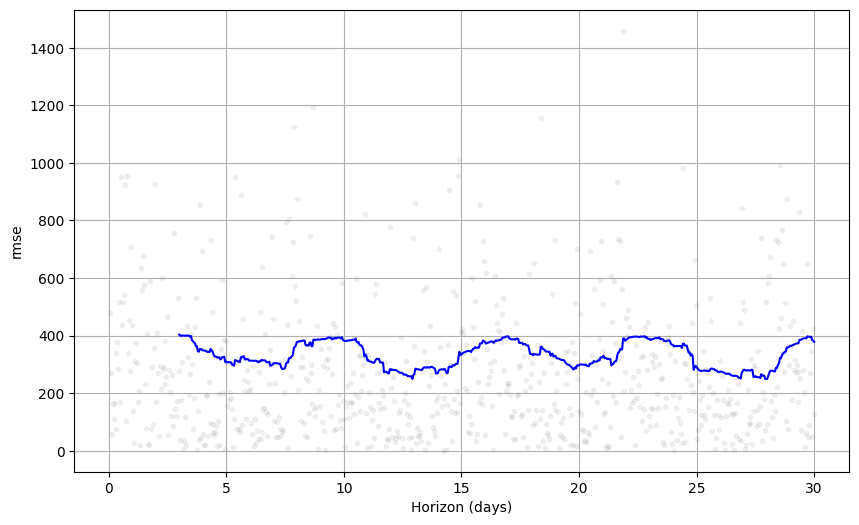

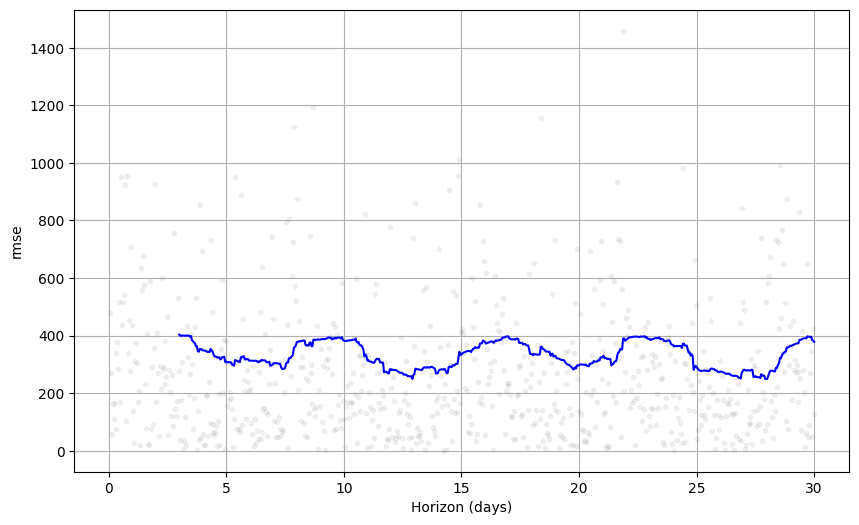

In [61]:
plot_cross_validation_metric(best_params_cv_res, metric='rmse')


## Deep learning for time series forecasting
Several approaches exist for time series forecasting and deep learning has 
proven to be one of the accurate ones hence explored here. Recurrent Neural 
Networks (RNN) are designed to be well suited for sequence data and 
Long Short Term Memory (LSTM) has made significant contribution in 
this area. A number of deep learning models will be 
experimented. Due to the limited time for computation, the models will 
be trained with limited epoch and an architecture that allows experimentation within 
the timeframe allowed.


Features used

In addition to the time series data, date and time related features were generated 
from the datetime feature for the analysis. This included, day of the week and month,
whether a given day is a weekend or not, hour of the day among others.

Horiron style is adopted for training and evaluation the forecast. 
The models are trained on a 48 hours window and then used to predict 
the next 10 hours horizon. By this, when the model is trained on 
1 to 48 hours, it is used to forecast 49th to 50th hour and then the 
trained on 2nd to 49th hour data to predict the 50th hour to 60th hour
in that manner. This informed how the data was splitted and 
prepared for training. For the testing dataset, the last 10 hours of 
all the was reserved. The remaining dataset is used for 
training and validation.



## Feature engineering
The datetime features were created as follows:


In [64]:
brochure_install_prep_transform = brochure_install_prep.copy()

brochure_install_prep_transform['day_of_week'] = brochure_install_prep_transform['ds'].dt.day_of_week
brochure_install_prep_transform['hour'] = brochure_install_prep_transform['ds'].dt.hour
brochure_install_prep_transform['month_day'] = brochure_install_prep_transform['ds'].dt.day
brochure_install_prep_transform['weekend'] = (np.where(brochure_install_prep_transform['ds']
                                             .dt.day_name().isin(["Saturday", "Sunday"]), 
                                             1, 0
                                             )
                                    )

In [65]:
validate_multivar = brochure_install_prep_transform.tail(10)
#brochure_install_prep_transform[2:].tail(10)

In [66]:
# The rest of the data excluding testing dataset is used for training and validation.
train_multivar = brochure_install_prep_transform.drop(validate_multivar.index)


### Data preprocessing

Numeric features such as day of the month, view duration among others 
were scaled using MinMax scaling. The weekend feature which indicates,
whether a day is a weekend or not is binary with weekends assigned the 
value of 1. Thus, this feature is not numeric hence not scaled like 
the other numeric features.
Normalization is done as an attempt to reduce training time for 
convergence  


In [68]:
x_multi_scaler = preprocessing.MinMaxScaler()

In [69]:
columns_to_scale = train_multivar.columns[2:-1]

In [70]:
x_multi_scaler.fit_transform(train_multivar[columns_to_scale]).shape

(2918, 4)

In [71]:
train_multivar[columns_to_scale] = x_multi_scaler.transform(train_multivar[columns_to_scale])


### Data splitting for horion style forecasting

Splitting the data for horizon style forecasting as describe earlier is 
undertake as follows:


In [73]:
def horizon_style_data_splitter(predictors: pd.DataFrame, 
                                target: pd.DataFrame, start: int, 
                                end: int, window: int, horizon: int
                                ):
    X = []
    y = []
    start = start + window
    if end is None:
        end = len(predictors) - horizon
        
    for i in range(start, end):
        indices = range(i-window, i)
        X.append(predictors.iloc[indices])
        
        indicey = range(i+1, i+1+horizon)
        y.append(target.iloc[indicey])
    return np.array(X), np.array(y)


dataX = train_multivar[train_multivar.columns[1:]] 

dataY = train_multivar[['y']] 

In [74]:
hist_window_multi = 48
horizon_multi = 10
TRAIN_SPLIT = 2100

x_train_multi, y_train_multi = horizon_style_data_splitter(predictors=dataX, target=dataY,
                                                         start=0, end=TRAIN_SPLIT,
                                                         window=hist_window_multi,
                                                         horizon=horizon_multi
                                                         )

x_val_multi, y_val_multi = horizon_style_data_splitter(predictors=dataX, target=dataY,
                                                     start=TRAIN_SPLIT, end=None,
                                                     window=hist_window_multi,
                                                     horizon=horizon_multi
                                                     )


During each training session, only a subset of the all training samples are used. 
Training in batches requires specifing the sample to to train for each mini-batch.
This is define to be 64.


In [76]:
BATCH_SIZE = 64
BUFFER_SIZE = 100


train_data_multi = tf.data.Dataset.from_tensor_slices((x_train_multi, y_train_multi))
train_data_multi = train_data_multi.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()

val_data_multi = tf.data.Dataset.from_tensor_slices((x_val_multi, y_val_multi))
val_data_multi = val_data_multi.batch(BATCH_SIZE).repeat()

### Evaluation of models

The performance of the model will be assessed based on RMSE and other evaluation metrics 
will be reported. This will reported using function defined below:

In [77]:


def timeseries_evaluation_metrics(y_true, y_pred):
    def mean_absolute_percentage_error(y_true, y_pred):
        y_true, y_pred = np.array(y_true), np.array(y_pred)
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    print('Evaluation metric results:-')
    print(f'MSE is : {metrics.mean_squared_error(y_true, y_pred)}')
    print(f'MAE is : {metrics.mean_absolute_error(y_true, y_pred)}')
    print(f'RMSE is : {np.sqrt(metrics.mean_squared_error(y_true, y_pred))}')
    print(f'MAPE is : {mean_absolute_percentage_error(y_true, y_pred)}')
    print(f'R2 is : {metrics.r2_score(y_true, y_pred)}', end='\n\n')

Understanding the validation loss changes over various epoch is important to gauge whether 
further training will bring about any improvement to decide the next line of action. 
For this, a function is defined to plot the loss history as follows:


In [78]:
def plot_loss_history(history):
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train loss', 'validation loss'], loc='upper left')
    plt.rcParams['figure.figsize'] = [16, 9]
    return plt.show()

### Long Short Term Memory (LSTM) for forecasting

LSTM is define for training and forecasting page turn count. The architecture is defined 
to include 556 neurons for the input layer that feeds directly to a hidden layer 
of 556 neurons and two other hidden layers down stream with 256 neurons. The output layer
makes a prediction for 10 outputs which corresponds to the number of forecasting horizons
defined to be 10 hours. This simplified architecture forms the basis for most of the 
models implemented. LSTM is defined as follows:


In [80]:
tf.random.set_seed(2023)
np.random.seed(2023)

lstm_multi = tf.keras.models.Sequential()
lstm_multi.add(tf.keras.layers.LSTM(units=556, input_shape=x_train_multi.shape[-2:], 
                                    return_sequences=True)
               )
lstm_multi.add(tf.keras.layers.LSTM(units=556, return_sequences=False))
lstm_multi.add(tf.keras.layers.Dense(256))
lstm_multi.add(tf.keras.layers.Dense(256))
lstm_multi.add(tf.keras.layers.Dense(units=horizon_multi))
lstm_multi.compile(optimizer='adam', loss='mse')

In [81]:
model_path_lstm_multi = 'model_store/lstm_multivariate.h5' 

In [82]:
EVALUATION_INTERVAL = 20
EPOCHS = 10
history_multi = lstm_multi.fit(x=train_data_multi, epochs=EPOCHS, 
                         steps_per_epoch=EVALUATION_INTERVAL,
                         validation_data=val_data_multi,
                         validation_steps=5, verbose=1, 
                         callbacks=[
                                    tf.keras.callbacks.ModelCheckpoint(model_path_lstm_multi, 
                                                                       monitor='val_loss',
                                                                       save_best_only=True,
                                                                       mode="min",
                                                                       verbose=0
                                                                       )
                                    ]
                         )

Epoch 1/10
20/20 [==============================] - ETA: 0s - loss: 4734153.0000

/Users/lin/Documents/python_venvs/pytorch_deepL/lib/python3.9/site-packages/keras/src/engine/training.py:3000: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



20/20 [==============================] - 61s 3s/step - loss: 4734153.0000 - val_loss: 3616299.2500
Epoch 2/10
Epoch 2/10
20/20 [==============================] - 50s 3s/step - loss: 3780939.5000 - val_loss: 1855421.6250
Epoch 3/10
20/20 [==============================] - 67s 3s/step - loss: 2730044.2500 - val_loss: 2234230.0000
Epoch 4/10
20/20 [==============================] - 70s 4s/step - loss: 2150250.0000 - val_loss: 2093774.7500
Epoch 5/10
20/20 [==============================] - 52s 3s/step - loss: 3431749.0000 - val_loss: 2267974.0000
Epoch 6/10
20/20 [==============================] - 55s 3s/step - loss: 2589210.7500 - val_loss: 1852101.0000
Epoch 7/10
20/20 [==============================] - 49s 2s/step - loss: 2623004.0000 - val_loss: 1810863.0000
Epoch 8/10
20/20 [==============================] - 63s 3s/step - loss: 3075334.0000 - val_loss: 1996946.6250
Epoch 9/10
20/20 [==============================] - 49s 2s/step - loss: 2120158.5000 - val_loss: 1911716.7500
Epoch 10/1

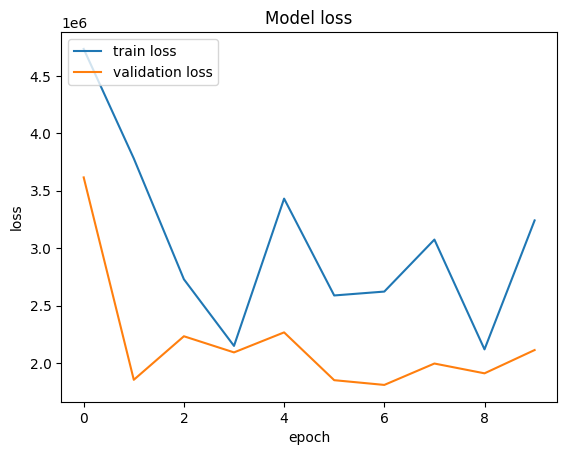

In [83]:
trained_model_multi = tf.keras.models.load_model(model_path_lstm_multi)

plot_loss_history(history_multi)

In [84]:
trained_model_multi.summary()

Model: "sequential"
_________________________________________________________________
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 48, 556)           1252112   
                                                                 
 lstm_1 (LSTM)               (None, 556)               2475312   
                                                                 
 dense (Dense)               (None, 256)               142592    
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dense_2 (Dense)             (None, 10)                2570      
                                                                 
Total params: 3938378 (15.02 MB)
Trainable params: 3938378 (15.02 MB)
Non-trainable params: 0 (0.00 Byte)
________________

### Preparing for forecasting

To forecast the number of page turn count for next 10 hours, 
the sequence of values as well as datetime features extracted are used. 
For this, the last 48 hours are feed to the model to forecast for the next 10 hours.
The forecast is compared with the ground truth in the test dataset and evaluation 
metrics are computed. This is implemented as follows:


In [86]:
data_val = train_multivar[train_multivar.columns[1:]].tail(48)
val_rescaled = np.array(data_val).reshape(1, data_val.shape[0], data_val.shape[1])
predicted_results = trained_model_multi.predict(val_rescaled)

1/1 [==============================] - 3s 3s/step


Evaluation metric results:-
MSE is : 199870.00846260338
MAE is : 382.4141479492188
RMSE is : 447.0682369198279
MAPE is : 17.641774365214474
R2 is : -0.3262963503633489



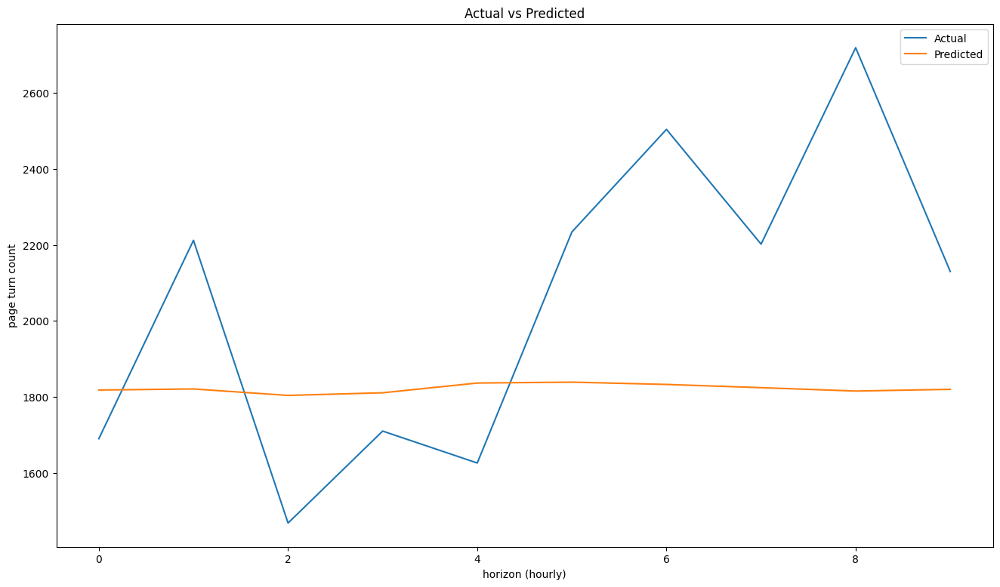

In [88]:
timeseries_evaluation_metrics(y_true=validate_multivar['y'],
                                   y_pred=predicted_results[0]
                                   )

def compare_forecast_actual_graph(forecast, actual, title="Actual vs Predicted",
                                  yaxsis_label="page turn count",
                                  xaxsis_label="horizon (hourly)",
                                  legend: set = ('Actual', 'Predicted')):
    plt.plot(list(actual['y']))
    plt.plot(list(forecast[0]))
    plt.title(title)
    plt.ylabel(yaxsis_label)
    plt.xlabel(xaxsis_label)
    plt.legend(legend)
    return plt.show()

compare_forecast_actual_graph(forecast=predicted_results, actual=validate_multivar)

The above process depicts how to use deep learning particularly LSTM for time series 
forecasting using both sequence of data and datetime features. This is a case of 
multivariant time series forecasting. 

The logic presented here holds true for a number of other deep learning forecasting models 
which are experimented hereafter. The code for such experimentation is provided for 
Bidirectional LSTM and Convolutional Neural Networks (CNN) as follows


The potential for bidrectional LSTM for forecasting page turn count is explored as follows:


In [92]:
bi_lstm_multi = tf.keras.models.Sequential()
bi_lstm_multi.add(tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(units=556, 
                                            input_shape=x_train_multi.shape[-2:], 
                                            return_sequences=True))
               )
bi_lstm_multi.add(tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(units=556, return_sequences=False))
                  )
bi_lstm_multi.add(tf.keras.layers.Dense(256))
bi_lstm_multi.add(tf.keras.layers.Dense(256))
bi_lstm_multi.add(tf.keras.layers.Dense(units=horizon_multi))
bi_lstm_multi.compile(optimizer='adam', loss='mse')

model_path_bilstm_multi = 'model_store/bi_lstm_multivariate.h5' 

The model is fit on the dataset ast follows:

In [94]:
bi_lstm_history_multi = bi_lstm_multi.fit(x=train_data_multi, epochs=EPOCHS, 
                         steps_per_epoch=EVALUATION_INTERVAL,
                         validation_data=val_data_multi,
                         validation_steps=5, verbose=1, 
                         callbacks=[
                                    tf.keras.callbacks.ModelCheckpoint(model_path_bilstm_multi, 
                                                                       monitor='val_loss',
                                                                       save_best_only=True,
                                                                       mode="min",
                                                                       verbose=0
                                                                       )
                                    ]
                         )

Epoch 1/10
20/20 [==============================] - ETA: 0s - loss: 4163774.7500

/Users/lin/Documents/python_venvs/pytorch_deepL/lib/python3.9/site-packages/keras/src/engine/training.py:3000: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



20/20 [==============================] - 169s 8s/step - loss: 4163774.7500 - val_loss: 2449888.5000
Epoch 2/10
Epoch 2/10
20/20 [==============================] - 138s 7s/step - loss: 3327835.2500 - val_loss: 1814780.7500
Epoch 3/10
20/20 [==============================] - 122s 6s/step - loss: 3333335.5000 - val_loss: 1890498.2500
Epoch 4/10
20/20 [==============================] - 119s 6s/step - loss: 2118621.5000 - val_loss: 2005464.0000
Epoch 5/10
20/20 [==============================] - 120s 6s/step - loss: 3320585.7500 - val_loss: 2292050.5000
Epoch 6/10
20/20 [==============================] - 123s 6s/step - loss: 2591731.7500 - val_loss: 1862229.7500
Epoch 7/10
20/20 [==============================] - 119s 6s/step - loss: 2679934.7500 - val_loss: 1821781.7500
Epoch 8/10
20/20 [==============================] - 120s 6s/step - loss: 3118297.2500 - val_loss: 2061369.2500
Epoch 9/10
20/20 [==============================] - 111s 6s/step - loss: 2206242.5000 - val_loss: 2029965.6250
E

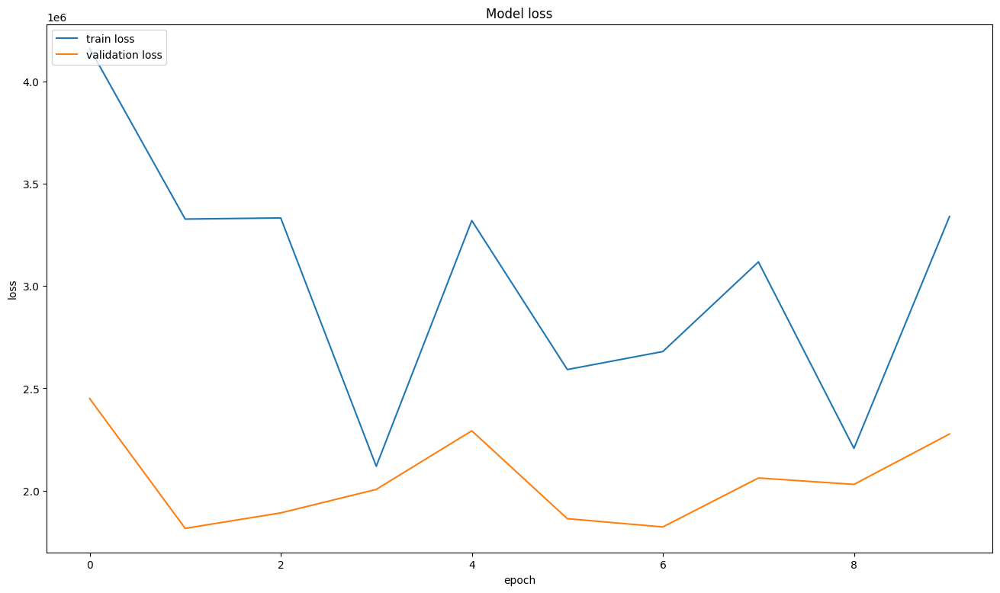

In [95]:
trained_model_bilstm_multi = tf.keras.models.load_model(model_path_bilstm_multi)

plot_loss_history(bi_lstm_history_multi)

In [96]:
trained_model_bilstm_multi.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional_2 (Bidirecti  (None, 48, 1112)          2504224   
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional_2 (Bidirecti  (None, 48, 1112)          2504224   
 onal)                                                           
                                                                 
 bidirectional_3 (Bidirecti  (None, 1112)              7423712   
 onal)                                                           
                                                                 
 dense_6 (Dense)             (None, 256)               284928    
                                                                 
 dense_7 (Dense)             (None, 256)               65792     
                                                      

In [97]:
bilstm_predicted_results = trained_model_bilstm_multi.predict(val_rescaled)

1/1 [==============================] - 5s 5s/step


In [98]:
timeseries_evaluation_metrics(y_true=validate_multivar['y'],
                                   y_pred=bilstm_predicted_results[0]
                                   )

Evaluation metric results:-
MSE is : 214035.3798696205
MAE is : 390.51405029296876
RMSE is : 462.6395787971674
MAPE is : 17.8256345432129
R2 is : -0.42029484740240486



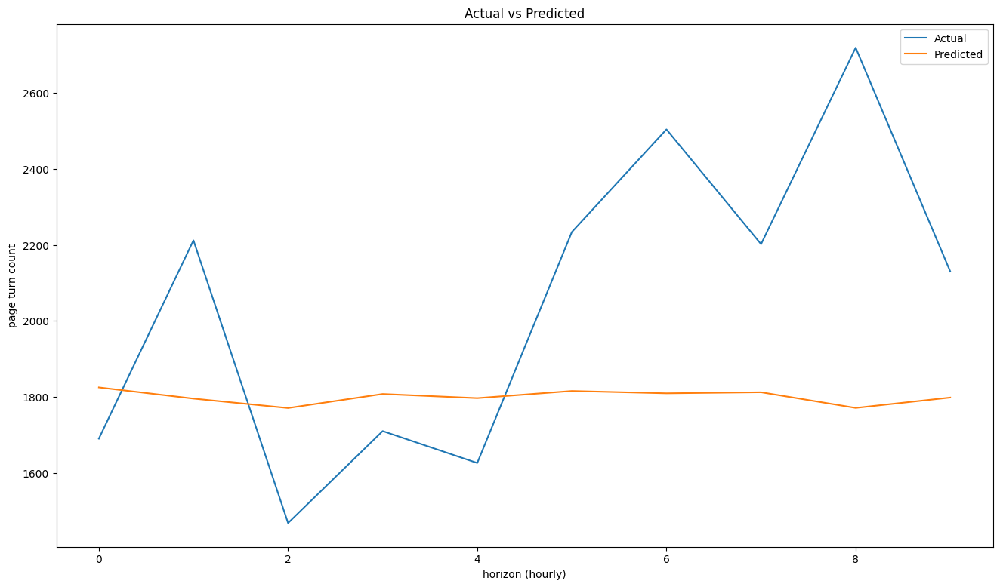

In [100]:
compare_forecast_actual_graph(forecast=bilstm_predicted_results, actual=validate_multivar)


CNN has also been used for analyzing sequential data and this is demonstrated as follows.
An important observation was that training of the convolutional model was 
significantly faster compared 
to the other models


In [102]:
cnn_model_multi = Sequential()
cnn_model_multi.add(Conv1D(filters=64, kernel_size=3, activation='relu',
                                       input_shape=(x_train_multi.shape[1],
                                                    x_train_multi.shape[2]
                                                    )
                                       )
                                )
cnn_model_multi.add(MaxPool1D(pool_size=2))
cnn_model_multi.add(tf.keras.layers.Dense(556))
cnn_model_multi.add(Flatten())
cnn_model_multi.add(Dense(556, activation='relu'))
cnn_model_multi.add(tf.keras.layers.Dense(256))
cnn_model_multi.add(tf.keras.layers.Dense(256))
cnn_model_multi.add(Dense(horizon_multi))
cnn_model_multi.compile(optimizer='adam', loss='mse')

In [103]:
model_path_cnn_multi = 'model_store/cnn_multivariate.h5' 

In [104]:
cnn_history_multi = cnn_model_multi.fit(x=train_data_multi, epochs=10, 
                         steps_per_epoch=EVALUATION_INTERVAL,
                         validation_data=val_data_multi,
                         validation_steps=5, verbose=1, 
                         callbacks=[
                                    tf.keras.callbacks.ModelCheckpoint(model_path_cnn_multi, 
                                                                       monitor='val_loss',
                                                                       save_best_only=True,
                                                                       mode="min",
                                                                       verbose=0
                                                                       )
                                    ]
                         )

Epoch 1/10
20/20 [==============================] - ETA: 0s - loss: 2329316.5000

/Users/lin/Documents/python_venvs/pytorch_deepL/lib/python3.9/site-packages/keras/src/engine/training.py:3000: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



20/20 [==============================] - 9s 246ms/step - loss: 2329316.5000 - val_loss: 1473954.7500
Epoch 2/10
Epoch 2/10
20/20 [==============================] - 6s 313ms/step - loss: 1394012.3750 - val_loss: 985956.6250
Epoch 3/10
20/20 [==============================] - 6s 325ms/step - loss: 1167640.7500 - val_loss: 933462.6250
Epoch 4/10
20/20 [==============================] - 4s 213ms/step - loss: 945003.4375 - val_loss: 1086839.6250
Epoch 5/10
20/20 [==============================] - 3s 143ms/step - loss: 1250836.1250 - val_loss: 1019538.3125
Epoch 6/10
20/20 [==============================] - 3s 146ms/step - loss: 708399.6250 - val_loss: 999884.3750
Epoch 7/10
20/20 [==============================] - 3s 163ms/step - loss: 864932.7500 - val_loss: 1106784.5000
Epoch 8/10
20/20 [==============================] - 4s 220ms/step - loss: 980802.1250 - val_loss: 879292.8125
Epoch 9/10
20/20 [==============================] - 5s 213ms/step - loss: 705033.5625 - val_loss: 968950.8125
Ep

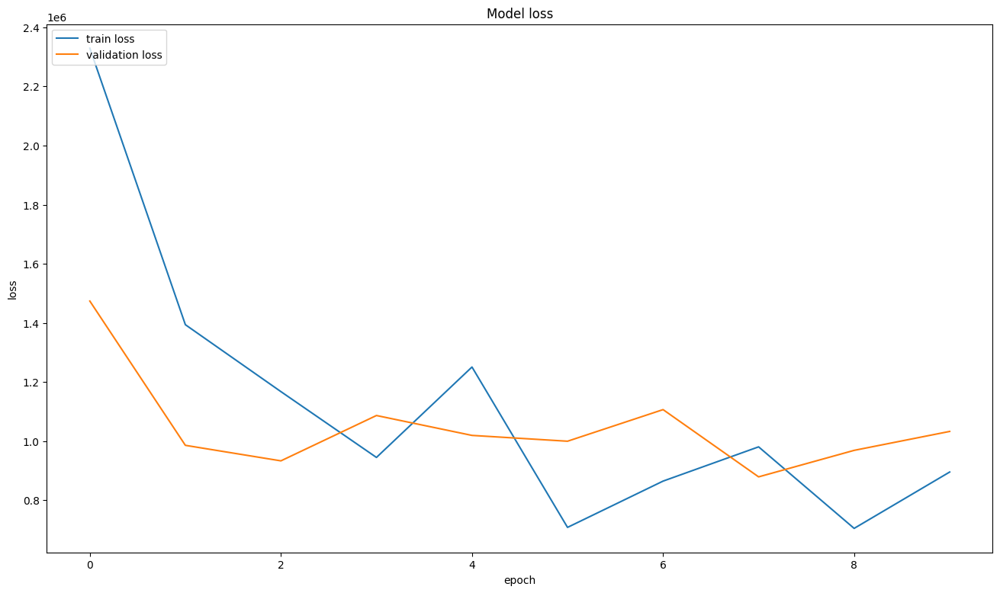

In [105]:
trained_model_cnn_multi = tf.keras.models.load_model(model_path_cnn_multi)

plot_loss_history(cnn_history_multi)

In [106]:
trained_model_cnn_multi.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, 46, 64)            1216      
                                                                 
 max_pooling1d (MaxPooling1  (None, 23, 64)            0         
 D)                                                              
                                                                 
 dense_9 (Dense)             (None, 23, 556)           36140     
                                                                 
 flatten (Flatten)           (None, 12788)             0         
                                                                 
 dense_10 (Dense)            (None, 556)               7110684   
                                                      

In [107]:
cnn_predicted_results = trained_model_cnn_multi.predict(val_rescaled)

1/1 [==============================] - 0s 315ms/step


In [108]:
timeseries_evaluation_metrics(y_true=validate_multivar['y'],
                                y_pred=cnn_predicted_results[0]
                            )

Evaluation metric results:-
MSE is : 166123.45798653067
MAE is : 362.506103515625
RMSE is : 407.58245544494514
MAPE is : 19.067472486263007
R2 is : -0.10236116830154285



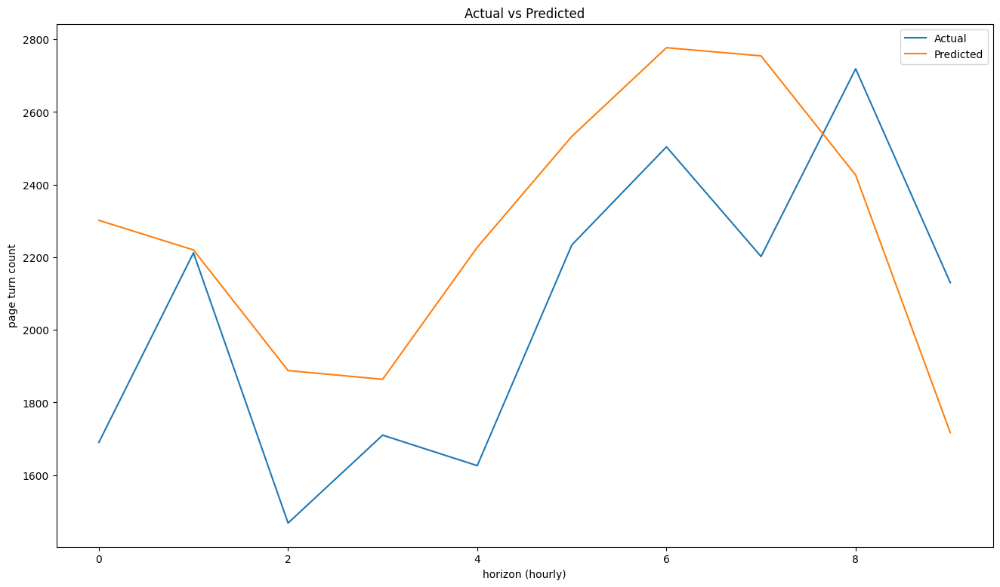

In [109]:
compare_forecast_actual_graph(forecast=cnn_predicted_results, actual=validate_multivar)


### Machine learning models for time series 

In order to use machine learning models for forecasting, data should not be shuffle as would have 
been the case under normal circumstances and also the date time features can 
be extracted and used for the analysis. Other time series relevant predictors, 
that can be used is the trend and seasonal, moving averages, lag values among others.
For this task, only the datetime features are used.

With the aim of experimenting several models, the whole machine learning task will be broken 
down into individual tasks and models with object oriented style that can be reused. 

The various models for which the files can be found in the repo are as follows:

preprocess_pipeline: contains the data preprocessing pipeline  

model_train: contain a class for training the models

candidate_models: contains the list of models to experiment with.

datetime_feature_transform: contains class for feature transformation

get_path: a helper for reading path of data without thinking about relative file directory

For details about the whole modeling process, the files identified can be checked.

The rest of the code demonstrates the various models and classes written can be used to 
automate experimentation of serveral models and streamline the workflow. The aim is to 
make the machine learning task self-contained. A flat folder structure is maintained. Hyperparameter 
optimization is not undertaken for the sake time.


In [111]:
# import all models to be used

from get_path import get_data_path
from arguments import args
from datetime_feature_transform import DatetimeFeatureTransformer
from model_train import Model
import pandas as pd

In [112]:
datapath = get_data_path(folder_name='data_store', file_name='brochure_install_prep.csv')

data = pd.read_csv(datapath)

In [113]:
# The class for extracted date and time related features is implemented as follows
dft = DatetimeFeatureTransformer(data=data)

dft.datetime_feature_transform(datetime_column='ds')

,Unnamed: 0,ds,y,view_duration,day_of_week,hour,month_day,weekend
0,0,2017-04-01 00:00:00,2.0,29000.0,5,0,1,1
1,1,2017-04-01 01:00:00,24.0,42000.0,5,1,1,1
2,2,2017-04-01 02:00:00,0.0,0.0,5,2,1,1
3,3,2017-04-01 03:00:00,0.0,0.0,5,3,1,1
4,4,2017-04-01 04:00:00,99.0,212000.0,5,4,1,1
...,...,...,...,...,...,...,...,...
2923,2923,2017-07-31 19:00:00,2234.0,9514084.0,0,19,31,0
2924,2924,2017-07-31 20:00:00,2504.0,11131581.0,0,20,31,0
2925,2925,2017-07-31 21:00:00,2202.0,10958040.0,0,21,31,0
2926,2926,2017-07-31 22:00:00,2719.0,11798226.0,0,22,31,0


In [114]:
## A copy of the data is made and prepared for splitting
transformed_data = dft.data.copy()

In [115]:
transformed_data.drop(columns=['Unnamed: 0'], inplace=True)

For this all data in July will be used as the test set and the rest of the data occurring 
before July will be used for training. By this, about 75% of the data is used for training.

In [116]:
train_ml_df = transformed_data[transformed_data['ds'].dt.month < 7].copy()

test_ml_df = transformed_data[transformed_data['ds'].dt.month > 6]

In [117]:
# The predictors and target variable are defined as follows
X_train = train_ml_df[['view_duration', 'day_of_week', 'hour', 'month_day', 'weekend']]

y_train = train_ml_df[['y']]

X_test = test_ml_df[['view_duration', 'day_of_week', 'hour', 'month_day', 'weekend']]

y_test = test_ml_df[['y']]

In [118]:
# Class for the model is initiatlized using the dataset as follows:
reg_model = Model(training_features=X_train, training_target_variable=y_train,
                    test_features=X_test, test_target_variable=y_test
                    )

The next step is to experiment with several machine learning models and evaluated them 
on test set. The evaluation metric is RMSE about 10 algrothms were trained with default parameters.


In [119]:

reg_model.run_regressors()

/Users/lin/Documents/python_venvs/pytorch_deepL/lib/python3.9/site-packages/sklearn/pipeline.py:346: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

/Users/lin/Documents/python_venvs/pytorch_deepL/lib/python3.9/site-packages/sklearn/utils/validation.py:63: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

/Users/lin/Documents/python_venvs/pytorch_deepL/lib/python3.9/site-packages/sklearn/utils/validation.py:63: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

/Users/lin/Documents/python_venvs/pytorch_deepL/lib/python3.9/site-packages/sklearn/utils/validation.py:63: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the s

,model_name,test_rmse
0,Extra decision tree,546.945398
1,Decision tree,531.192558
2,Radom forest Regressor,405.893046
3,SVR poly,920.564112
4,SVR linear,486.936325
5,SVR rbf,1138.703057
6,Linear regression,392.781375
7,Extreme Gradient Boosting,395.640422
8,Extreme gradient boosting with Random Forest,395.640422
9,Histogram gradient boosting,405.060464


In [120]:
# A plot comparing the performance of the various models is provided as follows:
reg_model.plot_regressors_test_rmse_results()

In [121]:
## The name of the best model can be obtained as follows:
reg_model.get_best_model_name()

'Linear regression'

In [122]:
## The best model can fitted and used for prediction
reg_model.best_model_fitted

best candidate model being fit on data
model fitting completed


Pipeline(steps=[('columntransformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('standardscaler',
                                                  StandardScaler(),
                                                  ['view_duration',
                                                   'day_of_week', 'hour',
                                                   'month_day']),
                                                 ('onehotencoder',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  [])])),
                ('linearregression', LinearRegression())])